In [1]:
import os
import torch
from torchvision import datasets, transforms, models
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader

data_dir = "/kaggle/input/new-data/new_dataset"
commercial_dir = os.path.join(data_dir, "commercial")
non_commercial_dir = os.path.join(data_dir, "non_commercial")

transform = transforms.Compose([
    transforms.Resize(224),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

dataset = datasets.ImageFolder(data_dir, transform=transform)

train_ratio = 0.7
val_ratio = 0.2
test_ratio = 0.1
train_size = int(train_ratio * len(dataset))
val_size = int(val_ratio * len(dataset))
test_size = len(dataset) - train_size - val_size

train_data, val_data, test_data = torch.utils.data.random_split(dataset, [train_size, val_size, test_size])




In [2]:
class CustomVGG16(nn.Module):
    def __init__(self):
        super(CustomVGG16, self).__init__()

        model = models.vgg16(pretrained=True)

        for param in model.features.parameters():
            param.requires_grad = False

        self.features = model.features
        self.avgpool = model.avgpool

        self.classifier = nn.Sequential(
            nn.Linear(512 * 7 * 7, 4096),
            nn.ReLU(True),
            nn.Dropout(),
            nn.Linear(4096, 4096),
            nn.ReLU(True),
            nn.Dropout(),
            nn.Linear(4096, 2),
        )

    def forward(self, x):
        x = self.features(x)
        x = self.avgpool(x)
        x = torch.flatten(x, 1)
        x = self.classifier(x)
        return x


In [3]:
custom_vgg16 = CustomVGG16()
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
custom_vgg16.to(device)

criterion = torch.nn.CrossEntropyLoss()
optimizer = optim.SGD(custom_vgg16.parameters(), lr=0.001, momentum=0.9)

train_loader = DataLoader(train_data, batch_size=32, shuffle=True)
val_loader = DataLoader(val_data, batch_size=32, shuffle=False)
test_loader = DataLoader(test_data, batch_size=32, shuffle=False)

train_losses = []
train_accuracies = []
val_losses = []
val_accuracies = []

num_epochs = 10
for epoch in range(num_epochs):
    custom_vgg16.train()
    train_loss = 0.0
    correct_train = 0
    total_train = 0
    for images, labels in train_loader:
        images, labels = images.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = custom_vgg16(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        train_loss += loss.item()
        _, predicted = torch.max(outputs.data, 1)
        total_train += labels.size(0)
        correct_train += (predicted == labels).sum().item()

    train_losses.append(train_loss / len(train_loader))
    train_accuracies.append(100 * correct_train / total_train)

    custom_vgg16.eval()
    val_loss = 0.0
    correct_val = 0
    total_val = 0
    with torch.no_grad():
        for images, labels in val_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = custom_vgg16(images)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            total_val += labels.size(0)
            correct_val += (predicted == labels).sum().item()

    val_losses.append(val_loss / len(val_loader))
    val_accuracies.append(100 * correct_val / total_val)

    print(f"Epoch {epoch + 1}/{num_epochs}, Train Loss: {train_losses[-1]}, Val Loss: {val_losses[-1]}, Train Accuracy: {train_accuracies[-1]}, Val Accuracy: {val_accuracies[-1]}")


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:02<00:00, 215MB/s]  


Epoch 1/10, Train Loss: 0.6274202787876129, Val Loss: 0.5235377252101898, Train Accuracy: 65.20100502512562, Val Accuracy: 87.66519823788546
Epoch 2/10, Train Loss: 0.3968105655908585, Val Loss: 0.38949450105428696, Train Accuracy: 88.31658291457286, Val Accuracy: 88.98678414096916
Epoch 3/10, Train Loss: 0.24098729372024535, Val Loss: 0.3150085713714361, Train Accuracy: 92.71356783919597, Val Accuracy: 90.7488986784141
Epoch 4/10, Train Loss: 0.16089898556470872, Val Loss: 0.2559341546148062, Train Accuracy: 95.97989949748744, Val Accuracy: 93.83259911894272
Epoch 5/10, Train Loss: 0.11142728835344315, Val Loss: 0.20497922878712416, Train Accuracy: 97.73869346733669, Val Accuracy: 94.27312775330397
Epoch 6/10, Train Loss: 0.06950798317790031, Val Loss: 0.18057806231081486, Train Accuracy: 98.86934673366834, Val Accuracy: 94.27312775330397
Epoch 7/10, Train Loss: 0.050966174378991126, Val Loss: 0.16450699605047703, Train Accuracy: 99.2462311557789, Val Accuracy: 94.7136563876652
Epoch 

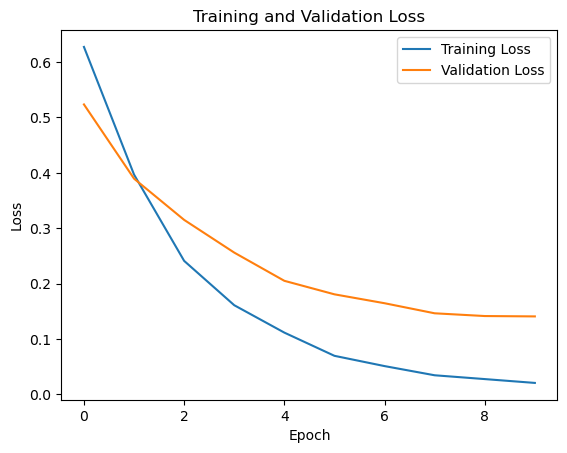

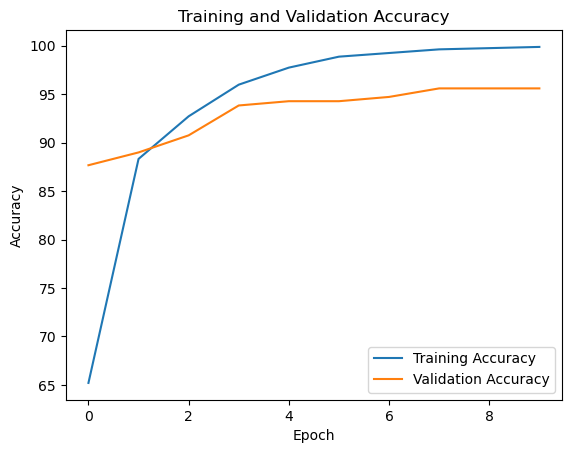

In [4]:
import matplotlib.pyplot as plt

# Plot training and validation loss
plt.figure()
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.show()

# Plot training and validation accuracy
plt.figure()
plt.plot(train_accuracies, label='Training Accuracy')
plt.plot(val_accuracies, label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Training and Validation Accuracy')
plt.legend()
plt.show()


In [5]:
from sklearn.metrics import precision_recall_fscore_support

custom_vgg16.eval()
y_true = []
y_pred = []

with torch.no_grad():
    for images, labels in test_loader:
        images, labels = images.to(device), labels.to(device)
        outputs = custom_vgg16(images)
        _, predicted = torch.max(outputs.data, 1)
        y_true.extend(labels.cpu().numpy())
        y_pred.extend(predicted.cpu().numpy())

precision, recall, f1_score, _ = precision_recall_fscore_support(y_true, y_pred, average='binary')

print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1_score:.4f}")

Precision: 0.9792
Recall: 0.8868
F1 Score: 0.9307


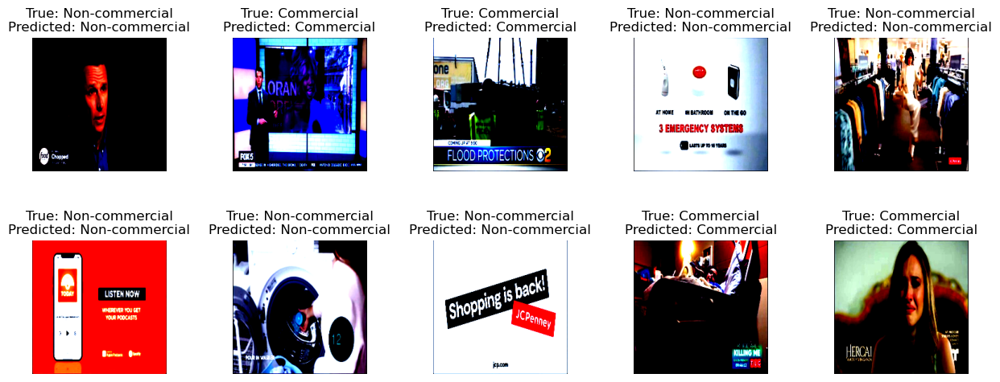

In [6]:
import random
import matplotlib.pyplot as plt


random_indices = random.sample(range(len(test_data)), 10)

# Visualize the frames with their true and predicted labels
fig, axes = plt.subplots(2, 5, figsize=(15, 6))
axes = axes.ravel()

for i, idx in enumerate(random_indices):
    image, label = test_data[idx]
    image_tensor = image.unsqueeze(0).to(device)
    output = custom_vgg16(image_tensor)
    _, predicted = torch.max(output.data, 1)
    predicted_label = 'Commercial' if predicted.item() == 1 else 'Non-commercial'
    true_label = 'Commercial' if label == 1 else 'Non-commercial'

    axes[i].imshow(image.permute(1, 2, 0).numpy())
    axes[i].set_title(f"True: {true_label}\nPredicted: {predicted_label}")
    axes[i].axis('off')

plt.subplots_adjust(wspace=0.5)
plt.show()


In [7]:
torch.save(custom_vgg16.state_dict(), 'path_to_save_model.pth')


In [12]:
import cv2
import os
import torch
from PIL import Image
from torchvision import transforms, models
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader

# Create directory to store frames
frames_dir = '/kaggle/working/frames'
os.makedirs(frames_dir, exist_ok=True)

# Load video
cap = cv2.VideoCapture('/kaggle/input/video123/2022 Commercials Vol. 7 (TV Land - January 8).mp4')
fps = cap.get(cv2.CAP_PROP_FPS)  # get the frames per second
frame_count = 0

# Extract frames
while cap.isOpened():
    ret, frame = cap.read()
    if ret == False:
        break
    if frame_count % fps == 0:  # save frame every second
        cv2.imwrite(os.path.join(frames_dir, f'frame{int(frame_count/fps)}.jpg'), frame)
    frame_count += 1

cap.release()

# Define transform
transform = transforms.Compose([
    transforms.Resize(224),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Load and preprocess frames
frames = os.listdir(frames_dir)
frames = [frame for frame in frames if frame.endswith(('.jpg', '.jpeg', '.png'))]  # filter for image files
frames.sort()  # make sure frames are in correct order

images = []
for frame in frames:
    image = Image.open(os.path.join(frames_dir, frame))
    image = transform(image)  # use the same transform function used for training data
    images.append(image)

images = torch.stack(images)  # convert list of images to a tensor

# Load model
custom_vgg16 = CustomVGG16()
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
custom_vgg16.to(device)

# Save the model
torch.save(custom_vgg16.state_dict(), 'path_to_save_model.pth')

# Load the model
custom_vgg16.load_state_dict(torch.load('path_to_save_model.pth'))

# Classify frames
custom_vgg16.eval()  # set model to evaluation mode

for image in images:
    image = image.to(device).unsqueeze(0)  # add batch dimension and move to device
    output = custom_vgg16(image)
    _, prediction = torch.max(output, 1)
    print(prediction.item())  # print predicted class



/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
1
1
0
1
0
0
0
0
0
0
0
0
0
1
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


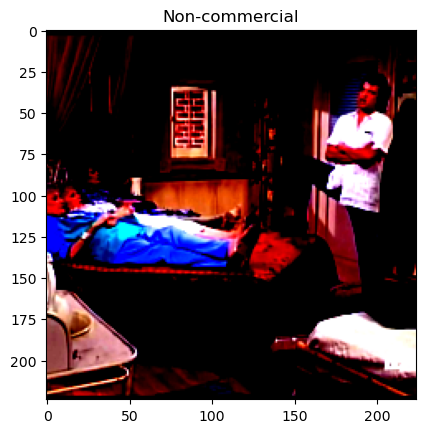

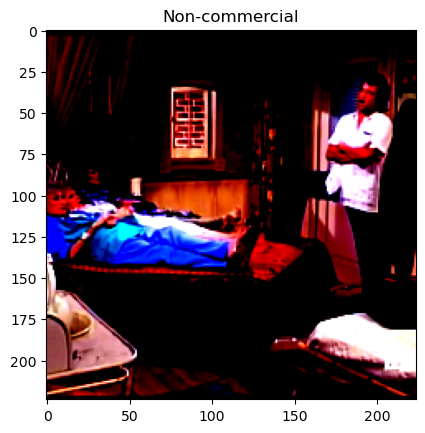

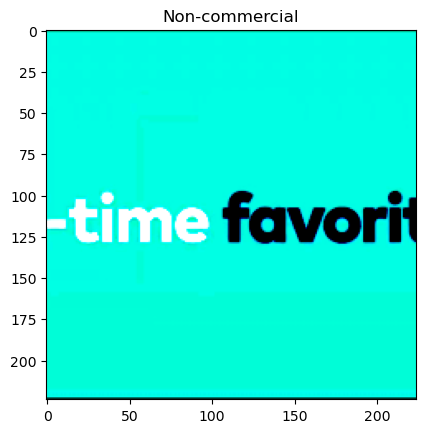

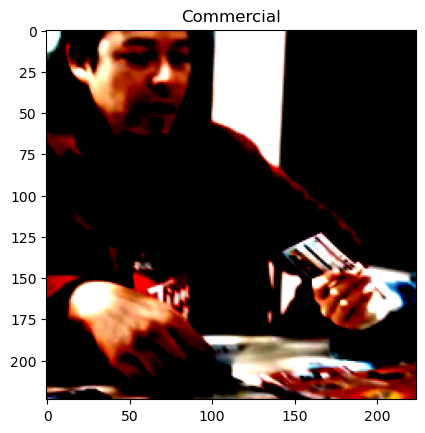

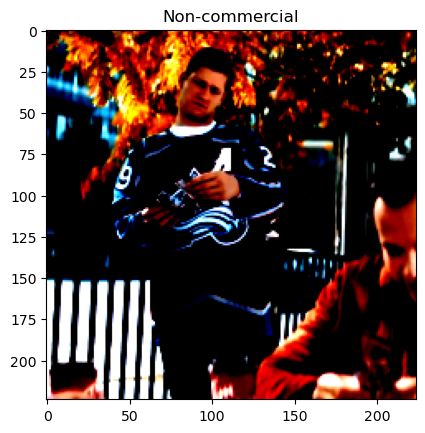

...

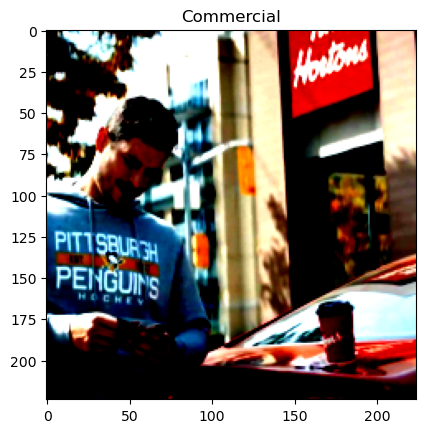

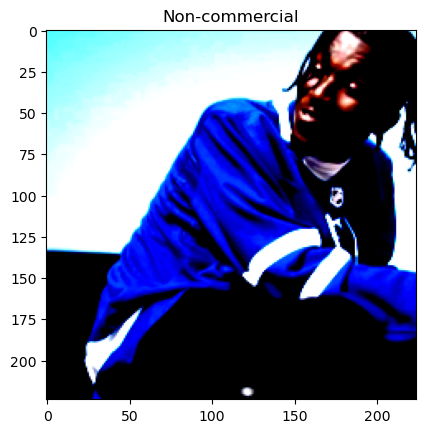

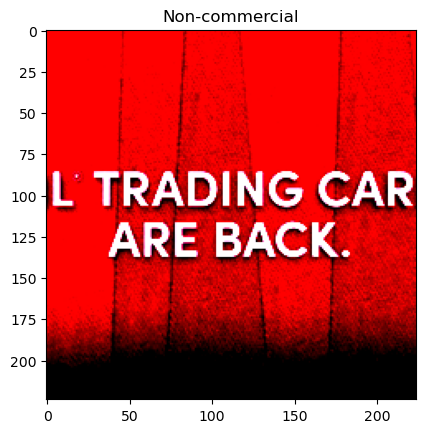

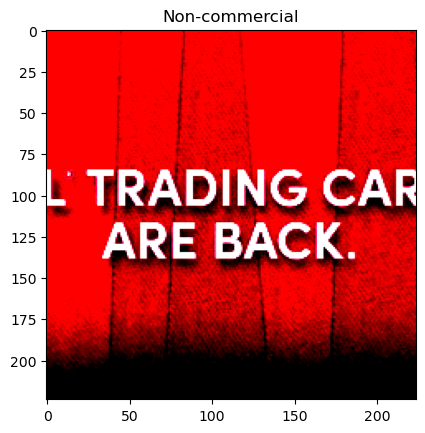

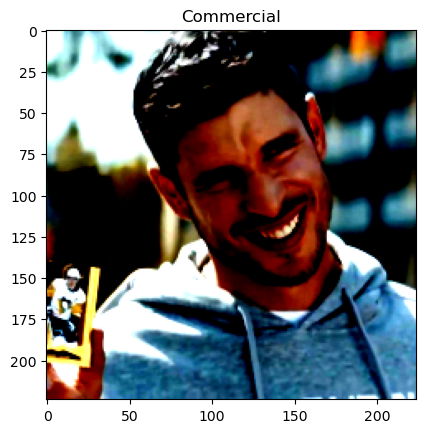

In [13]:
import cv2
import os
import torch
from PIL import Image
from torchvision import transforms, models
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt

# Create directory to store frames
frames_dir = '/kaggle/working/frames'
os.makedirs(frames_dir, exist_ok=True)

# Load video
cap = cv2.VideoCapture('/kaggle/input/video123/2022 Commercials Vol. 7 (TV Land - January 8).mp4')
fps = cap.get(cv2.CAP_PROP_FPS)  # get the frames per second
frame_count = 0

# Extract frames
while cap.isOpened():
    ret, frame = cap.read()
    if ret == False:
        break
    if frame_count % fps == 0:  # save frame every second
        cv2.imwrite(os.path.join(frames_dir, f'frame{int(frame_count/fps)}.jpg'), frame)
    frame_count += 1

cap.release()

# Define transform
transform = transforms.Compose([
    transforms.Resize(224),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Load and preprocess frames
frames = os.listdir(frames_dir)
frames = [frame for frame in frames if frame.endswith(('.jpg', '.jpeg', '.png'))]  # filter for image files
frames.sort()  # make sure frames are in correct order

images = []
for frame in frames:
    image = Image.open(os.path.join(frames_dir, frame))
    image = transform(image)  # use the same transform function used for training data
    images.append(image)

images = torch.stack(images)  # convert list of images to a tensor

# Load model
custom_vgg16 = CustomVGG16()
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
custom_vgg16.to(device)

# Save the model
torch.save(custom_vgg16.state_dict(), 'path_to_save_model.pth')

# Load the model
custom_vgg16.load_state_dict(torch.load('path_to_save_model.pth'))

# Classify frames
custom_vgg16.eval()  # set model to evaluation mode

for i, image in enumerate(images):
    image = image.to(device).unsqueeze(0)  # add batch dimension and move to device
    output = custom_vgg16(image)
    _, prediction = torch.max(output, 1)
    prediction = prediction.item()
    
    # Display image and label
    plt.imshow(image.cpu().squeeze(0).permute(1, 2, 0))
    plt.title('Commercial' if prediction == 0 else 'Non-commercial')
    plt.show()
